In [1]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import cv2
from collections import Counter
import random
from tqdm.notebook import tqdm
import logging
import glob
from scipy import stats
import matplotlib.cm as cm
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# Configure logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

# Set plot styling
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("viridis")

# Configure display options
pd.set_option('display.max_columns', None)
pd.set_option('display.expand_frame_repr', False)

In [2]:
try:
    # Define the dataset path
    dataset_base_path = '../dataset'
    
    if not os.path.exists(dataset_base_path):
        raise FileNotFoundError(f"Dataset path '{dataset_base_path}' does not exist")
    
    # Get all directories (crop types)
    crop_types = os.listdir(dataset_base_path)
    
    # Create a dictionary to store dataset structure
    dataset_structure = {}
    total_images = 0
    
    # Analyze dataset structure
    for crop in crop_types:
        crop_path = os.path.join(dataset_base_path, crop)
        
        if os.path.isdir(crop_path):
            disease_categories = [d for d in os.listdir(crop_path) 
                                if os.path.isdir(os.path.join(crop_path, d))]
            
            dataset_structure[crop] = {}
            
            for disease in disease_categories:
                disease_path = os.path.join(crop_path, disease)
                image_count = len(os.listdir(disease_path))
                dataset_structure[crop][disease] = image_count
                total_images += image_count
    
    # Print dataset summary
    print(f"Total number of crop types: {len(dataset_structure)}")
    print(f"Total number of images: {total_images}")
    
    # Convert to DataFrame for easier analysis
    structure_data = []
    for crop, diseases in dataset_structure.items():
        for disease, count in diseases.items():
            structure_data.append({
                "Crop": crop,
                "Disease": disease,
                "Image Count": count
            })
    
    df_structure = pd.DataFrame(structure_data)
    print(df_structure.head())
    
    # Display summary statistics
    summary_by_crop = df_structure.groupby('Crop').agg({
        'Disease': 'count',
        'Image Count': 'sum'
    }).rename(columns={'Disease': 'Disease Categories'})
    
    print("\nSummary by Crop Type:")
    print(summary_by_crop)
except Exception as e:
    logger.error(f"Error analyzing dataset structure: {str(e)}")
    raise

Total number of crop types: 9
Total number of images: 44054
          Crop           Disease  Image Count
0        Apple        Apple Scab         2016
1        Apple         Black Rot         1987
2        Apple  Cedar Apple Rust         1760
3        Apple           Healthy         2008
4  Bell Pepper    Bacterial Spot         1913

Summary by Crop Type:
              Disease Categories  Image Count
Crop                                         
Apple                          4         7771
Bell Pepper                    2         3901
Cherry                         2         3509
Corn (Maize)                   4         7664
Grape                          4         7335
Peach                          2         3566
Potato                         3         5957
Strawberry                     2         3689
Tomato                         8          662


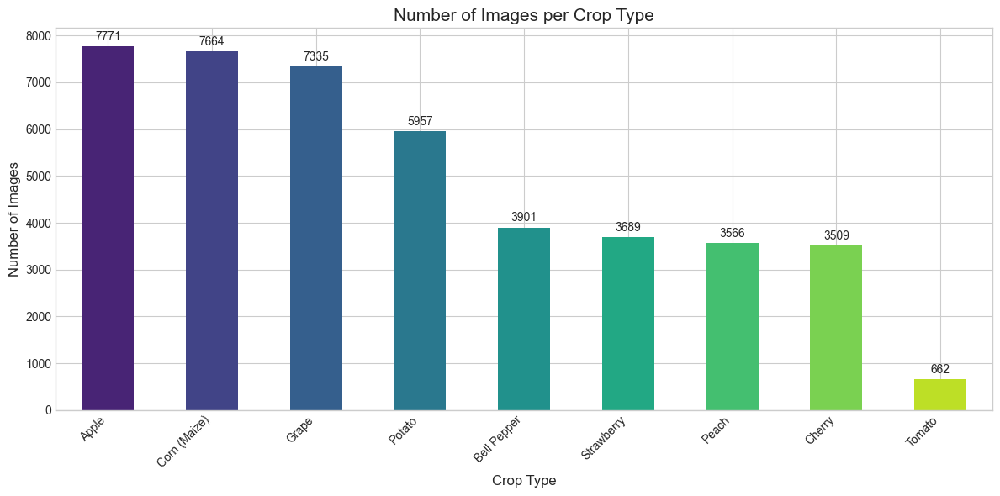

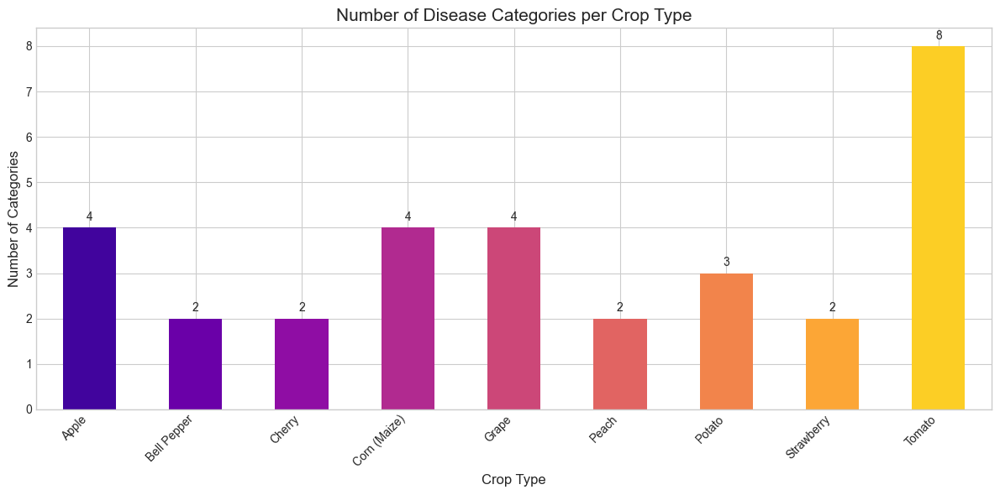

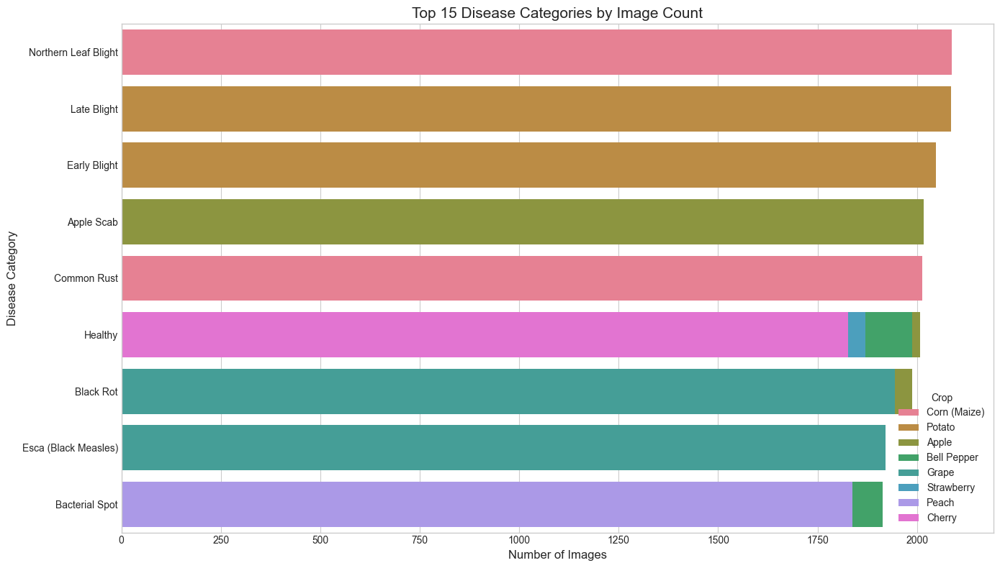

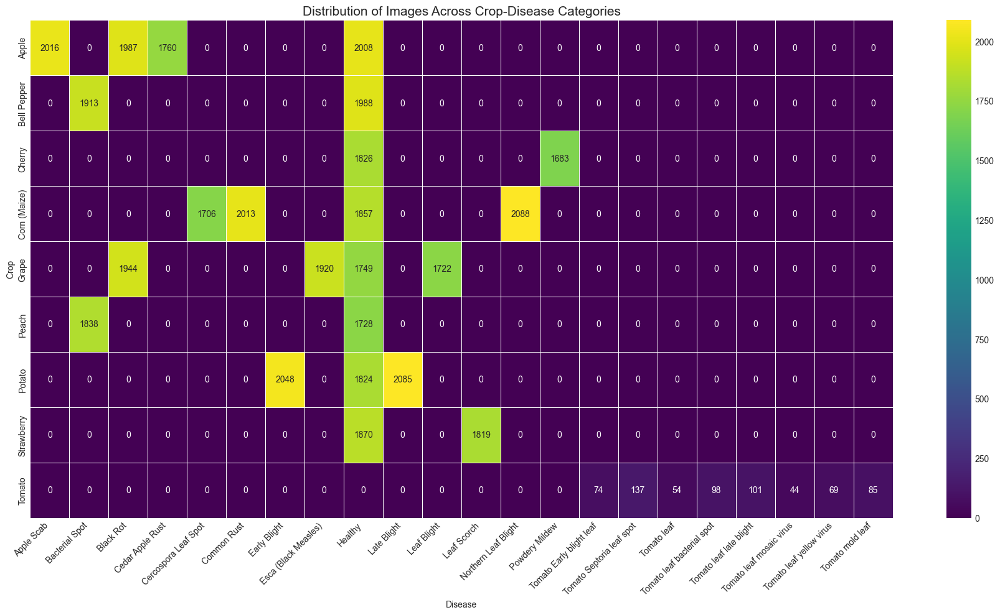

In [3]:
# Visualize data distribution across crops and diseases
try:
    # Plot 1: Distribution of images per crop type
    plt.figure(figsize=(12, 6))
    summary = df_structure.groupby('Crop')['Image Count'].sum().sort_values(ascending=False)
    ax = summary.plot(kind='bar', color=sns.color_palette("viridis", len(summary)))
    plt.title('Number of Images per Crop Type', fontsize=15)
    plt.xlabel('Crop Type', fontsize=12)
    plt.ylabel('Number of Images', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    
    # Add count labels on top of bars
    for i, count in enumerate(summary):
        plt.text(i, count + (summary.max() * 0.01), f"{count}", 
                 ha='center', va='bottom', fontsize=10)
    
    plt.tight_layout()
    plt.show()
    
    # Plot 2: Number of disease categories per crop
    plt.figure(figsize=(12, 6))
    category_counts = df_structure.groupby('Crop').size()
    ax = category_counts.plot(kind='bar', color=sns.color_palette("plasma", len(category_counts)))
    plt.title('Number of Disease Categories per Crop Type', fontsize=15)
    plt.xlabel('Crop Type', fontsize=12)
    plt.ylabel('Number of Categories', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    
    # Add count labels on top of bars
    for i, count in enumerate(category_counts):
        plt.text(i, count + 0.1, f"{count}", 
                 ha='center', va='bottom', fontsize=10)
    
    plt.tight_layout()
    plt.show()
    
    # Plot 3: Top 15 disease categories by image count
    plt.figure(figsize=(14, 8))
    top_diseases = df_structure.sort_values('Image Count', ascending=False).head(15)
    sns.barplot(x='Image Count', y='Disease', hue='Crop', data=top_diseases, dodge=False)
    plt.title('Top 15 Disease Categories by Image Count', fontsize=15)
    plt.xlabel('Number of Images', fontsize=12)
    plt.ylabel('Disease Category', fontsize=12)
    plt.tight_layout()
    plt.show()
    
    # Plot 4: Distribution of images across all categories (heatmap)
    plt.figure(figsize=(18, 10))
    pivot_df = df_structure.pivot(index='Crop', columns='Disease', values='Image Count').fillna(0)
    sns.heatmap(pivot_df, annot=True, fmt='.0f', cmap='viridis', linewidths=0.5)
    plt.title('Distribution of Images Across Crop-Disease Categories', fontsize=15)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()
except Exception as e:
    logger.error(f"Error creating distribution visualizations: {str(e)}")


In [4]:
# Analyze image properties across the dataset
try:
    # Sample images from each category for analysis
    max_samples_per_category = 50  # Limit samples to avoid memory issues
    image_properties = []
    
    for crop, diseases in tqdm(dataset_structure.items(), desc="Analyzing crops"):
        crop_path = os.path.join(dataset_base_path, crop)
        
        for disease, count in diseases.items():
            disease_path = os.path.join(crop_path, disease)
            
            # Get all image files
            image_files = os.listdir(disease_path)
            
            # Sample images if there are too many
            if len(image_files) > max_samples_per_category:
                image_files = random.sample(image_files, max_samples_per_category)
            
            for img_file in image_files:
                img_path = os.path.join(disease_path, img_file)
                
                try:
                    # Open image and get properties
                    with Image.open(img_path) as img:
                        width, height = img.size
                        aspect_ratio = width / height
                        mode = img.mode
                        
                        # Convert to numpy array and analyze colors
                        img_array = np.array(img.convert('RGB'))
                        avg_color = img_array.mean(axis=(0, 1))
                        std_color = img_array.std(axis=(0, 1))
                        
                        # Get image size in KB
                        file_size = os.path.getsize(img_path) / 1024
                        
                        image_properties.append({
                            'Crop': crop,
                            'Disease': disease,
                            'Filename': img_file,
                            'Width': width,
                            'Height': height,
                            'Aspect_Ratio': aspect_ratio,
                            'Mode': mode,
                            'File_Size_KB': file_size,
                            'Avg_R': avg_color[0],
                            'Avg_G': avg_color[1],
                            'Avg_B': avg_color[2],
                            'Std_R': std_color[0],
                            'Std_G': std_color[1],
                            'Std_B': std_color[2]
                        })
                except Exception as img_error:
                    logger.warning(f"Error analyzing image {img_path}: {str(img_error)}")
                    continue
    
    # Convert to DataFrame
    df_properties = pd.DataFrame(image_properties)
    
    # Display summary of image properties
    print("Image Properties Summary:")
    print(f"Total images analyzed: {len(df_properties)}")
    print("\nImage dimensions summary:")
    print(df_properties[['Width', 'Height', 'Aspect_Ratio']].describe())
    
    print("\nImage file size summary (KB):")
    print(df_properties['File_Size_KB'].describe())
    
    print("\nImage mode distribution:")
    print(df_properties['Mode'].value_counts())
except Exception as e:
    logger.error(f"Error analyzing image properties: {str(e)}")

Analyzing crops:   0%|          | 0/9 [00:00<?, ?it/s]

Image Properties Summary:
Total images analyzed: 1544

Image dimensions summary:
             Width       Height  Aspect_Ratio
count  1544.000000  1544.000000   1544.000000
mean    426.373057   390.459845      1.065014
std     461.134153   381.121165      0.205606
min     115.000000   100.000000      0.562324
25%     256.000000   256.000000      1.000000
50%     256.000000   256.000000      1.000000
75%     287.250000   256.000000      1.000000
max    4000.000000  3780.000000      3.409091

Image file size summary (KB):
count    1544.000000
mean       86.694219
std       324.335731
min         2.817383
25%        13.965088
50%        17.773926
75%        22.083008
max      4772.324219
Name: File_Size_KB, dtype: float64

Image mode distribution:
Mode
RGB     1543
RGBA       1
Name: count, dtype: int64


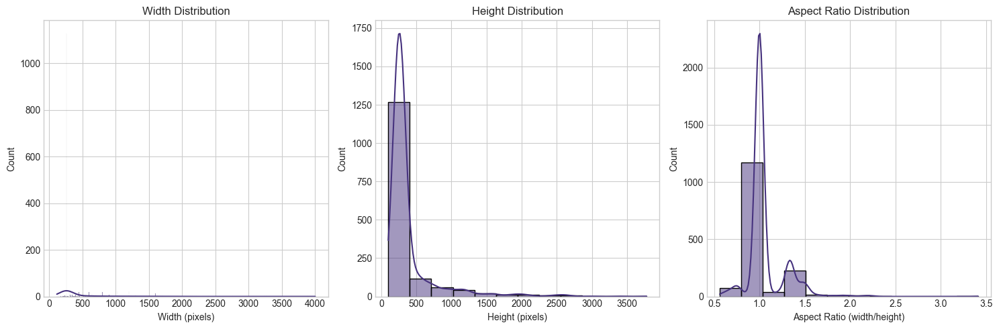

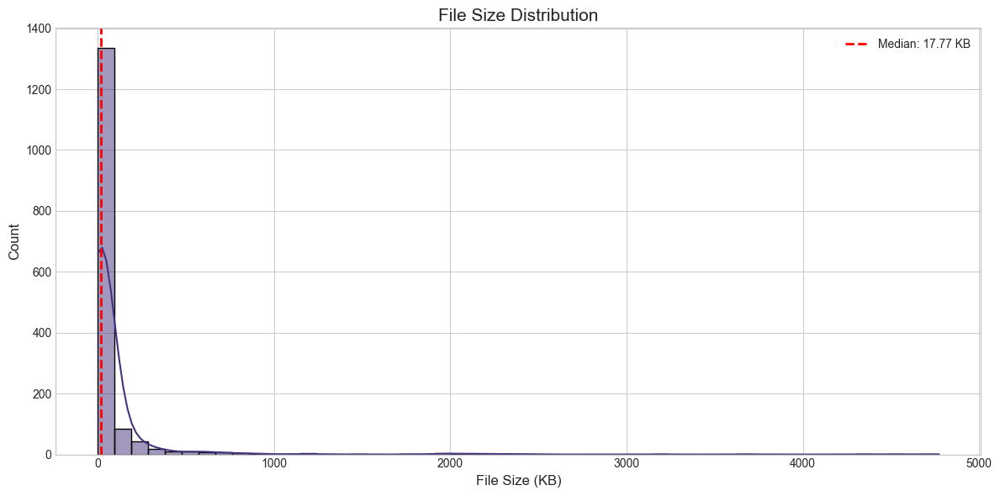

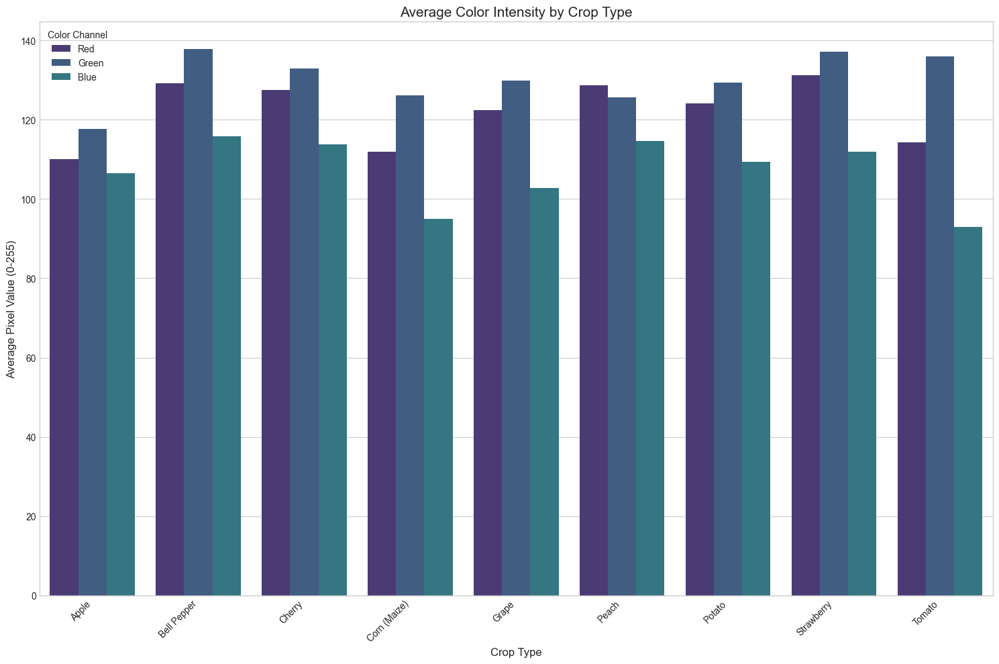

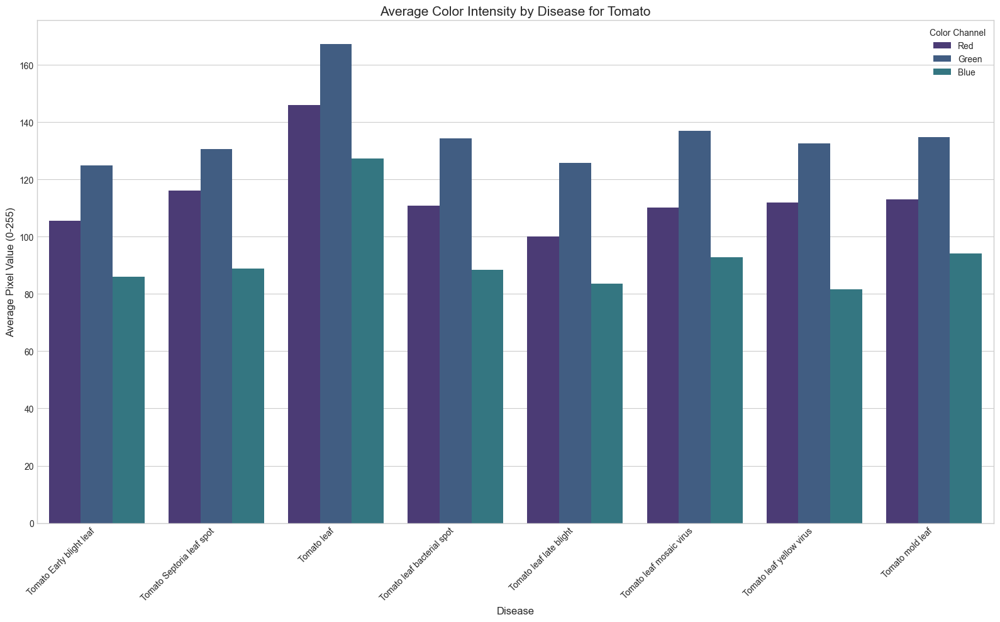

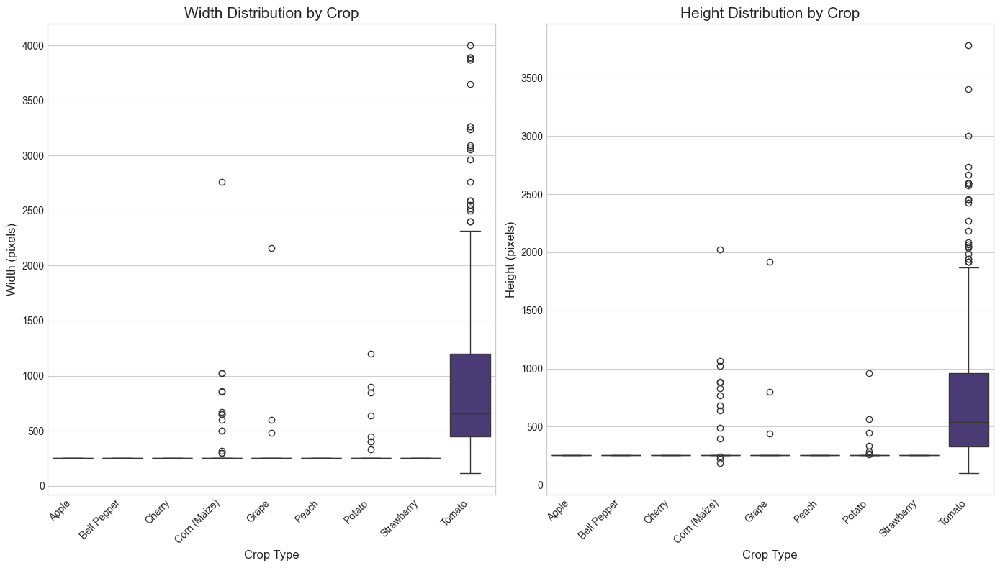

In [5]:
try:
    # Plot 1: Distribution of image dimensions
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 3, 1)
    sns.histplot(df_properties['Width'], kde=True)
    plt.title('Width Distribution')
    plt.xlabel('Width (pixels)')
    
    plt.subplot(1, 3, 2)
    sns.histplot(df_properties['Height'], kde=True)
    plt.title('Height Distribution')
    plt.xlabel('Height (pixels)')
    
    plt.subplot(1, 3, 3)
    sns.histplot(df_properties['Aspect_Ratio'], kde=True)
    plt.title('Aspect Ratio Distribution')
    plt.xlabel('Aspect Ratio (width/height)')
    
    plt.tight_layout()
    plt.show()
    
    # Plot 2: Distribution of file sizes
    plt.figure(figsize=(12, 6))
    sns.histplot(df_properties['File_Size_KB'], kde=True, bins=50)
    plt.title('File Size Distribution', fontsize=15)
    plt.xlabel('File Size (KB)', fontsize=12)
    plt.ylabel('Count', fontsize=12)
    plt.axvline(df_properties['File_Size_KB'].median(), color='red', linestyle='dashed', 
                linewidth=2, label=f"Median: {df_properties['File_Size_KB'].median():.2f} KB")
    plt.legend()
    plt.tight_layout()
    plt.show()
    
    # Plot 3: Color distribution by crop type
    plt.figure(figsize=(15, 10))
    
    # Melt the DataFrame for easier plotting
    color_cols = ['Avg_R', 'Avg_G', 'Avg_B']
    df_colors = df_properties.groupby('Crop')[color_cols].mean().reset_index()
    df_colors_melted = pd.melt(df_colors, id_vars=['Crop'], value_vars=color_cols,
                              var_name='Color Channel', value_name='Average Value')
    
    # Replace channel names for better readability
    df_colors_melted['Color Channel'] = df_colors_melted['Color Channel'].map({
        'Avg_R': 'Red', 'Avg_G': 'Green', 'Avg_B': 'Blue'
    })
    
    # Create the bar plot
    sns.barplot(x='Crop', y='Average Value', hue='Color Channel', data=df_colors_melted)
    plt.title('Average Color Intensity by Crop Type', fontsize=15)
    plt.xlabel('Crop Type', fontsize=12)
    plt.ylabel('Average Pixel Value (0-255)', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.legend(title='Color Channel')
    plt.tight_layout()
    plt.show()
    
    # Plot 4: Color distribution by disease (for a specific crop - choose the one with most categories)
    top_crop = summary_by_crop.sort_values('Disease Categories', ascending=False).index[0]
    
    plt.figure(figsize=(16, 10))
    crop_df = df_properties[df_properties['Crop'] == top_crop]
    color_cols = ['Avg_R', 'Avg_G', 'Avg_B']
    df_disease_colors = crop_df.groupby('Disease')[color_cols].mean().reset_index()
    df_disease_colors_melted = pd.melt(df_disease_colors, id_vars=['Disease'], 
                                      value_vars=color_cols,
                                      var_name='Color Channel', value_name='Average Value')
    
    df_disease_colors_melted['Color Channel'] = df_disease_colors_melted['Color Channel'].map({
        'Avg_R': 'Red', 'Avg_G': 'Green', 'Avg_B': 'Blue'
    })
    
    sns.barplot(x='Disease', y='Average Value', hue='Color Channel', data=df_disease_colors_melted)
    plt.title(f'Average Color Intensity by Disease for {top_crop}', fontsize=15)
    plt.xlabel('Disease', fontsize=12)
    plt.ylabel('Average Pixel Value (0-255)', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.legend(title='Color Channel')
    plt.tight_layout()
    plt.show()
    
    # Plot 5: Dimension variations across crops (boxplot)
    plt.figure(figsize=(14, 8))
    plt.subplot(1, 2, 1)
    sns.boxplot(x='Crop', y='Width', data=df_properties)
    plt.title('Width Distribution by Crop', fontsize=15)
    plt.xlabel('Crop Type', fontsize=12)
    plt.ylabel('Width (pixels)', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    
    plt.subplot(1, 2, 2)
    sns.boxplot(x='Crop', y='Height', data=df_properties)
    plt.title('Height Distribution by Crop', fontsize=15)
    plt.xlabel('Crop Type', fontsize=12)
    plt.ylabel('Height (pixels)', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    
    plt.tight_layout()
    plt.show()
except Exception as e:
    logger.error(f"Error creating image property visualizations: {str(e)}")

Displaying sample images from each crop-disease category:


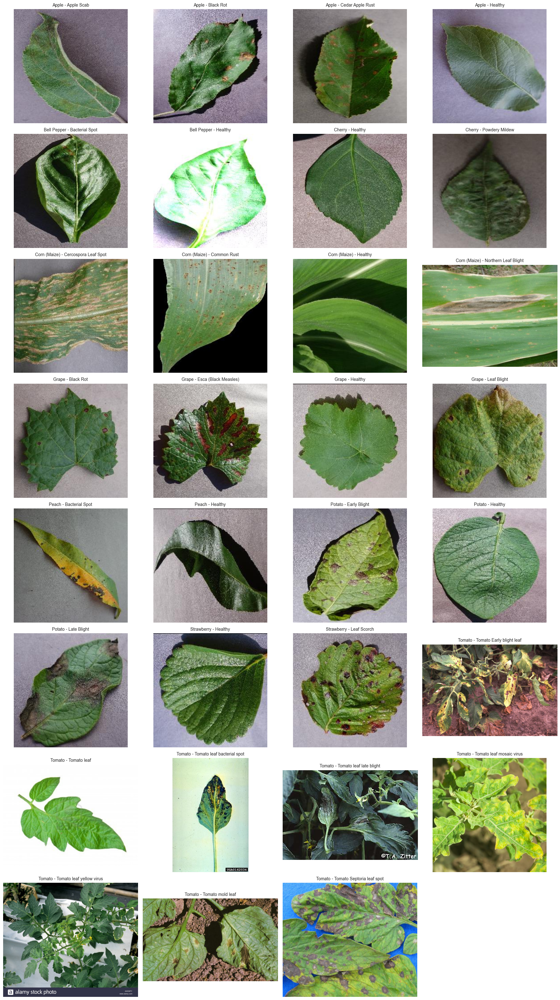


Displaying multiple samples for Tomato diseases:


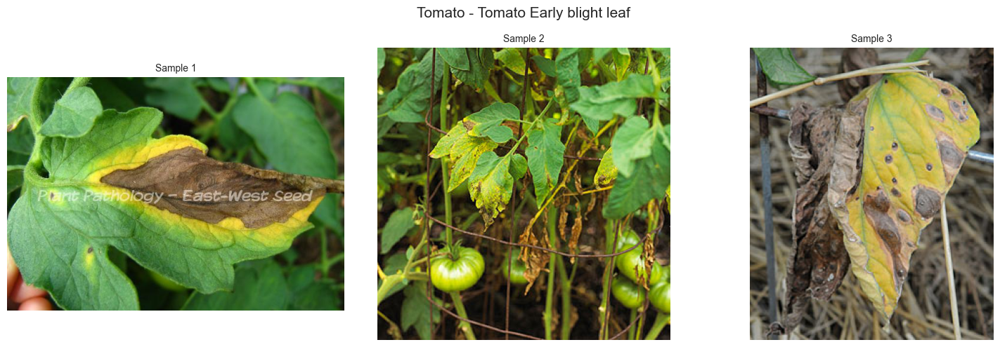

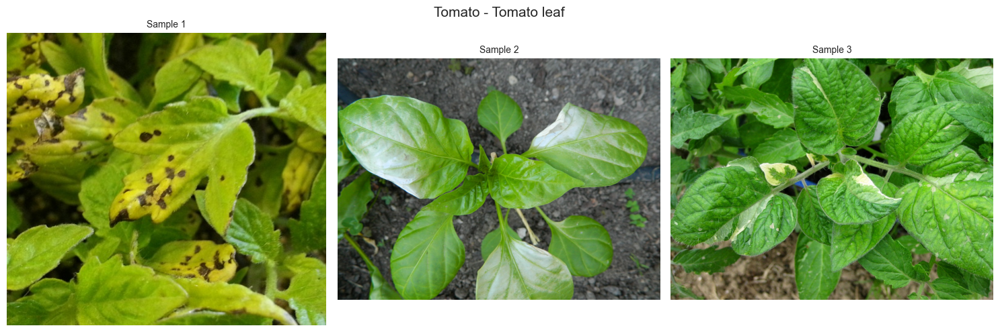

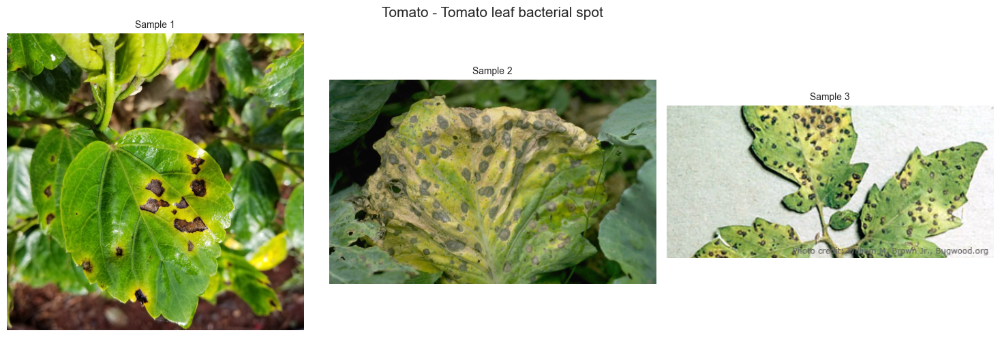

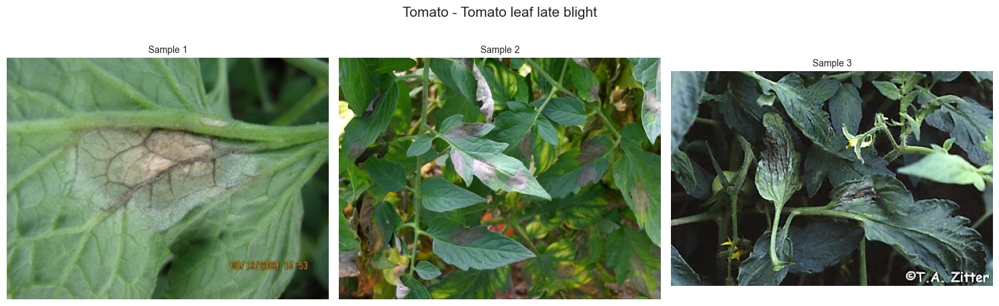

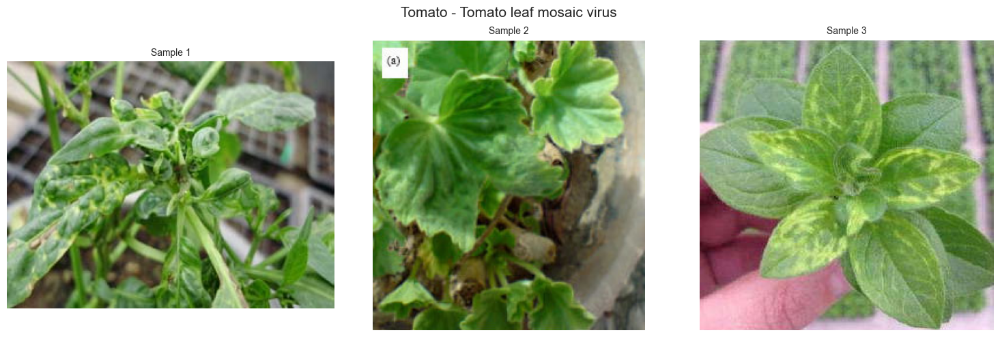

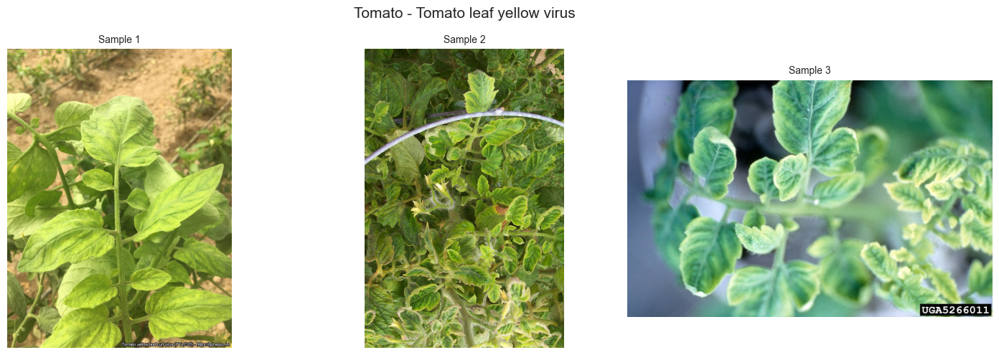

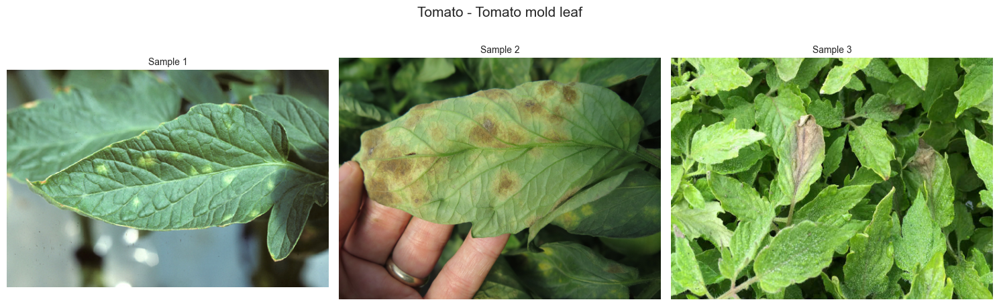

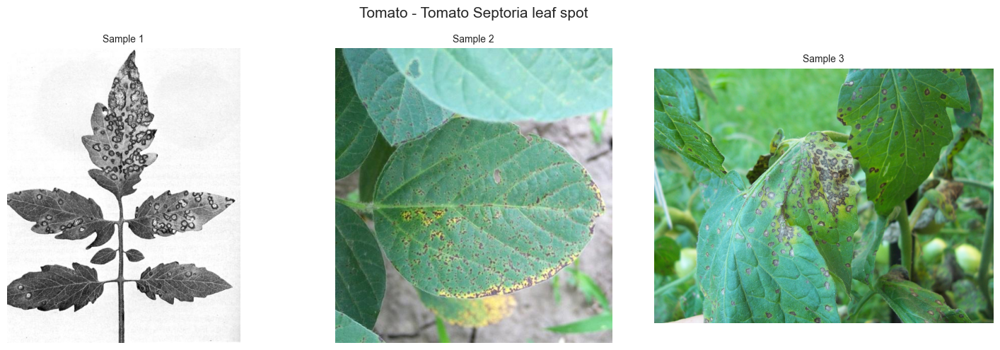

In [6]:
# Display sample images from each crop-disease category
try:
    # Function to display sample images in a grid
    def display_sample_images_grid(df_structure, dataset_base_path, samples_per_category=1):
        # Calculate grid dimensions
        total_categories = len(df_structure)
        cols = 4
        rows = (total_categories + cols - 1) // cols
        
        plt.figure(figsize=(18, 4 * rows))
        
        for i, (_, row) in enumerate(df_structure.iterrows()):
            crop = row['Crop']
            disease = row['Disease']
            category_path = os.path.join(dataset_base_path, crop, disease)
            
            if os.path.exists(category_path):
                image_files = os.listdir(category_path)
                
                if image_files:
                    # Select a random sample
                    sample_file = random.choice(image_files)
                    img_path = os.path.join(category_path, sample_file)
                    
                    try:
                        img = Image.open(img_path).convert('RGB')
                        
                        plt.subplot(rows, cols, i + 1)
                        plt.imshow(img)
                        plt.title(f"{crop} - {disease}", fontsize=10)
                        plt.axis('off')
                        
                        # Add image info
                        width, height = img.size
                        plt.xlabel(f"{width}x{height}", fontsize=8)
                    except Exception as img_error:
                        logger.warning(f"Error displaying image {img_path}: {str(img_error)}")
        
        plt.tight_layout()
        plt.show()
    
    # Display sample images from all categories
    print("Displaying sample images from each crop-disease category:")
    display_sample_images_grid(df_structure, dataset_base_path)
    
    # Display multiple samples for a single crop type (the one with most categories)
    top_crop = summary_by_crop.sort_values('Disease Categories', ascending=False).index[0]
    top_crop_df = df_structure[df_structure['Crop'] == top_crop]
    
    print(f"\nDisplaying multiple samples for {top_crop} diseases:")
    
    # Function to display multiple samples for a specific crop
    def display_crop_samples(crop_df, dataset_base_path, crop_name, samples_per_disease=3):
        diseases = crop_df['Disease'].unique()
        
        for disease in diseases:
            plt.figure(figsize=(15, 5))
            plt.suptitle(f"{crop_name} - {disease}", fontsize=15)
            
            disease_path = os.path.join(dataset_base_path, crop_name, disease)
            image_files = os.listdir(disease_path)
            
            # Select random samples
            if len(image_files) >= samples_per_disease:
                samples = random.sample(image_files, samples_per_disease)
            else:
                samples = image_files
            
            for i, img_file in enumerate(samples):
                img_path = os.path.join(disease_path, img_file)
                
                try:
                    img = Image.open(img_path).convert('RGB')
                    
                    plt.subplot(1, samples_per_disease, i + 1)
                    plt.imshow(img)
                    plt.title(f"Sample {i+1}", fontsize=10)
                    plt.axis('off')
                except Exception as img_error:
                    logger.warning(f"Error displaying image {img_path}: {str(img_error)}")
            
            plt.tight_layout()
            plt.show()
    
    display_crop_samples(top_crop_df, dataset_base_path, top_crop)
except Exception as e:
    logger.error(f"Error displaying sample images: {str(e)}")

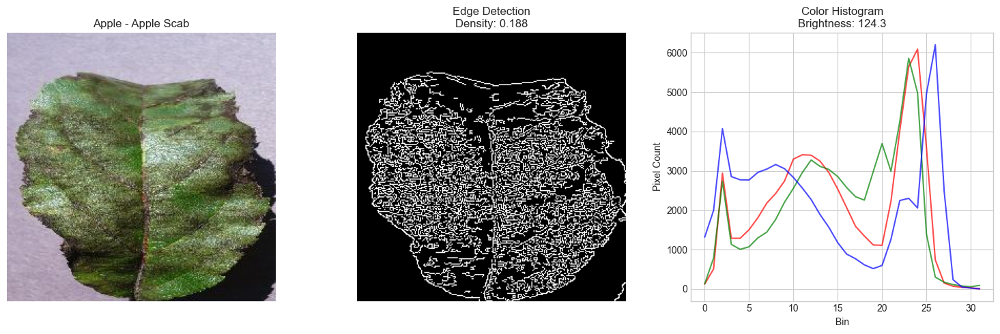

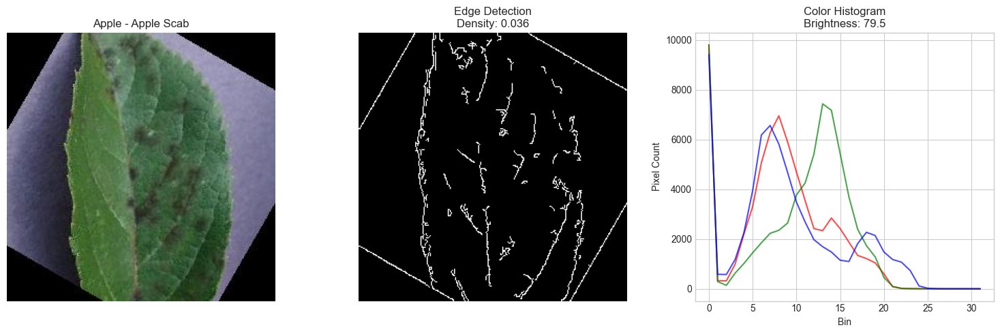

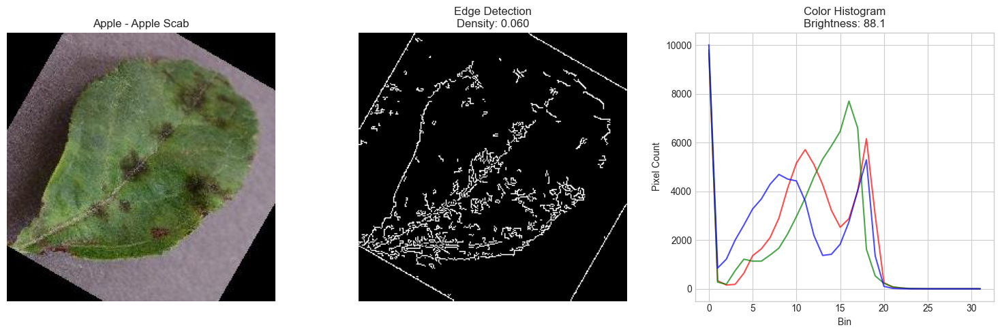

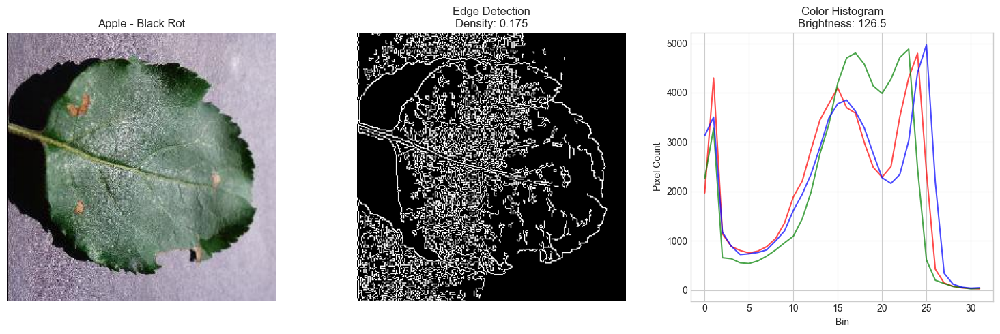

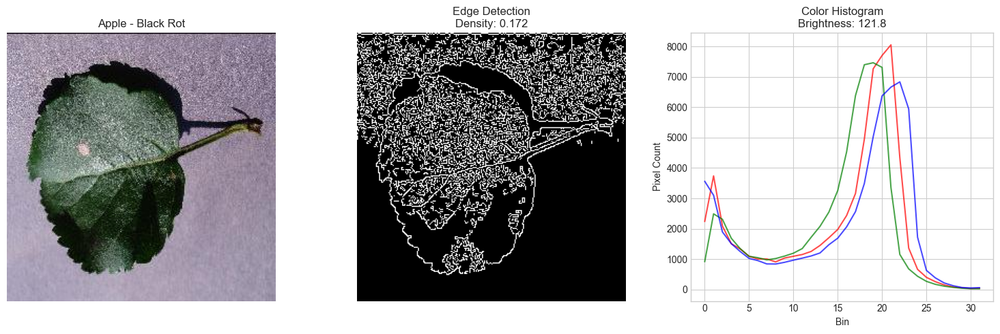

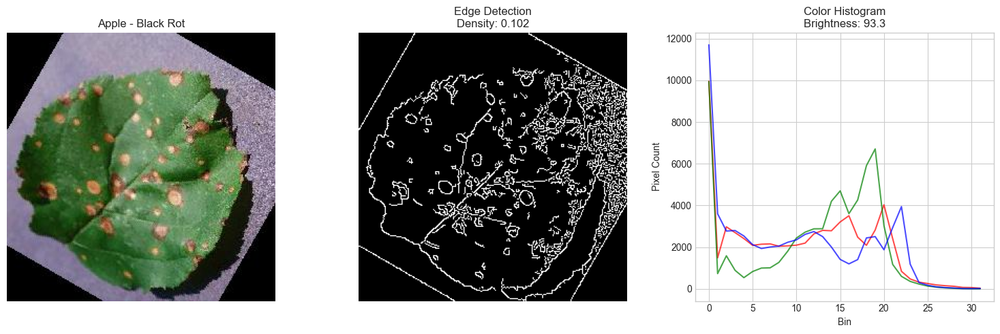

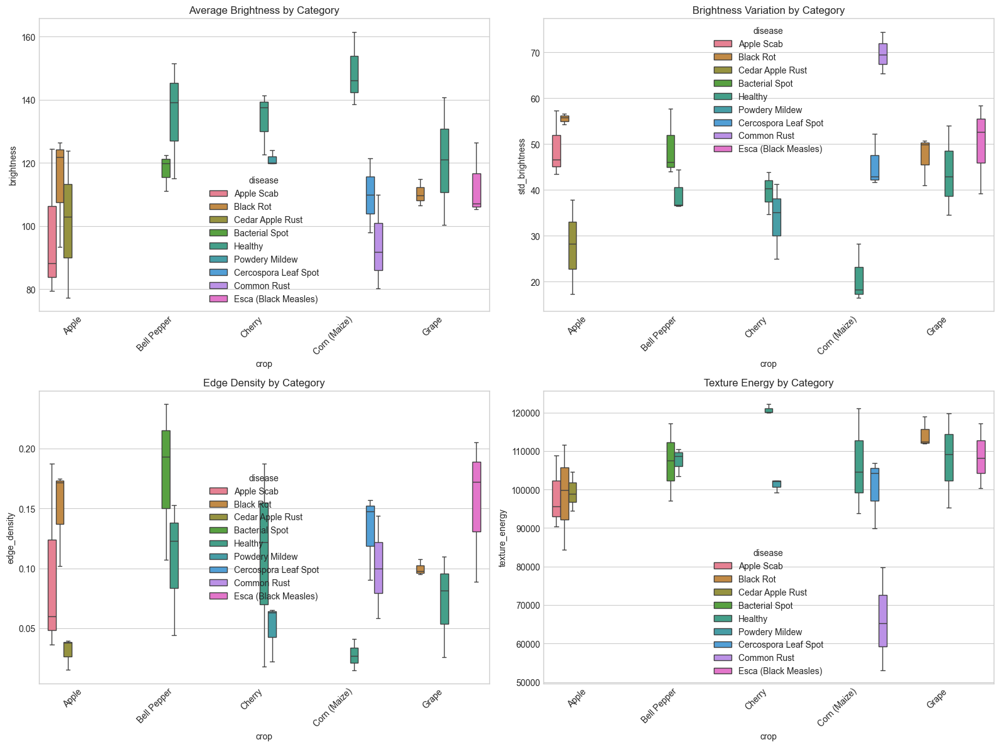

In [7]:
# Analyze image features using basic computer vision techniques
try:
    # Sample images for feature analysis
    sample_data = []
    
    # Function to extract basic features from images
    def extract_image_features(img_path):
        img = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        
        # Calculate basic features
        avg_brightness = np.mean(img_gray)
        std_brightness = np.std(img_gray)
        
        # Edge detection using Canny
        edges = cv2.Canny(img_gray, 100, 200)
        edge_density = np.count_nonzero(edges) / (edges.shape[0] * edges.shape[1])
        
        # Calculate color histogram
        hist_r = cv2.calcHist([img_rgb], [0], None, [32], [0, 256])
        hist_g = cv2.calcHist([img_rgb], [1], None, [32], [0, 256])
        hist_b = cv2.calcHist([img_rgb], [2], None, [32], [0, 256])
        
        # Texture analysis using Haralick features
        haralick = cv2.resize(img_gray, (100, 100))  # Resize for faster computation
        haralick_features = cv2.resize(img_gray, (32, 32))  # Further resize for basic texture
        texture_energy = np.sum(haralick_features ** 2)
        
        return {
            'avg_brightness': avg_brightness,
            'std_brightness': std_brightness,
            'edge_density': edge_density,
            'texture_energy': texture_energy,
            'histogram_r': hist_r.flatten(),
            'histogram_g': hist_g.flatten(),
            'histogram_b': hist_b.flatten(),
            'img_rgb': img_rgb,
            'edges': edges
        }
    
    # Sample a few images from each category
    max_crops = min(5, len(dataset_structure))
    samples_per_disease = 3
    sample_crops = list(dataset_structure.keys())[:max_crops]
    
    for crop in sample_crops:
        crop_path = os.path.join(dataset_base_path, crop)
        diseases = list(dataset_structure[crop].keys())
        
        for disease in diseases[:3]:  # Limit to 3 diseases per crop
            disease_path = os.path.join(crop_path, disease)
            image_files = os.listdir(disease_path)
            
            if len(image_files) >= samples_per_disease:
                samples = random.sample(image_files, samples_per_disease)
            else:
                samples = image_files
            
            for img_file in samples:
                img_path = os.path.join(disease_path, img_file)
                
                try:
                    features = extract_image_features(img_path)
                    
                    sample_data.append({
                        'crop': crop,
                        'disease': disease,
                        'filename': img_file,
                        'path': img_path,
                        'features': features
                    })
                except Exception as img_error:
                    logger.warning(f"Error extracting features from {img_path}: {str(img_error)}")
    
    # Display sample images with their features
    for i, sample in enumerate(sample_data[:6]):  # Show first 6 samples
        plt.figure(figsize=(15, 5))
        
        # Original Image
        plt.subplot(1, 3, 1)
        plt.imshow(sample['features']['img_rgb'])
        plt.title(f"{sample['crop']} - {sample['disease']}")
        plt.axis('off')
        
        # Edge Detection
        plt.subplot(1, 3, 2)
        plt.imshow(sample['features']['edges'], cmap='gray')
        plt.title(f"Edge Detection\nDensity: {sample['features']['edge_density']:.3f}")
        plt.axis('off')
        
        # Color Histogram
        plt.subplot(1, 3, 3)
        plt.plot(sample['features']['histogram_r'], color='r', alpha=0.7)
        plt.plot(sample['features']['histogram_g'], color='g', alpha=0.7)
        plt.plot(sample['features']['histogram_b'], color='b', alpha=0.7)
        plt.title(f"Color Histogram\nBrightness: {sample['features']['avg_brightness']:.1f}")
        plt.xlabel('Bin')
        plt.ylabel('Pixel Count')
        
        plt.tight_layout()
        plt.show()
    
    # Compare features across different disease categories
    feature_comparison = pd.DataFrame([
        {
            'crop': s['crop'],
            'disease': s['disease'],
            'brightness': s['features']['avg_brightness'],
            'std_brightness': s['features']['std_brightness'],
            'edge_density': s['features']['edge_density'],
            'texture_energy': s['features']['texture_energy']
        }
        for s in sample_data
    ])
    
    # Plot feature comparisons
    plt.figure(figsize=(16, 12))
    
    plt.subplot(2, 2, 1)
    sns.boxplot(x='crop', y='brightness', hue='disease', data=feature_comparison)
    plt.title('Average Brightness by Category')
    plt.xticks(rotation=45, ha='right')
    
    plt.subplot(2, 2, 2)
    sns.boxplot(x='crop', y='std_brightness', hue='disease', data=feature_comparison)
    plt.title('Brightness Variation by Category')
    plt.xticks(rotation=45, ha='right')
    
    plt.subplot(2, 2, 3)
    sns.boxplot(x='crop', y='edge_density', hue='disease', data=feature_comparison)
    plt.title('Edge Density by Category')
    plt.xticks(rotation=45, ha='right')
    
    plt.subplot(2, 2, 4)
    sns.boxplot(x='crop', y='texture_energy', hue='disease', data=feature_comparison)
    plt.title('Texture Energy by Category')
    plt.xticks(rotation=45, ha='right')
    
    plt.tight_layout()
    plt.show()
except Exception as e:
    logger.error(f"Error in image feature analysis: {str(e)}")


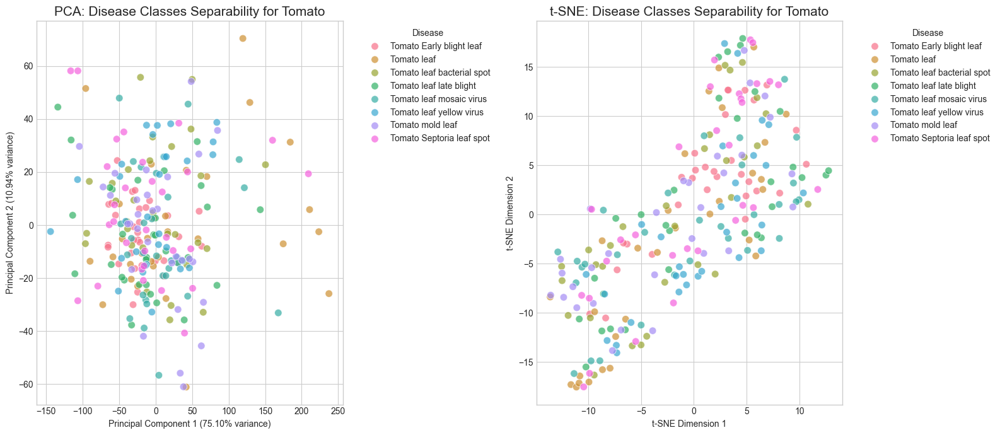

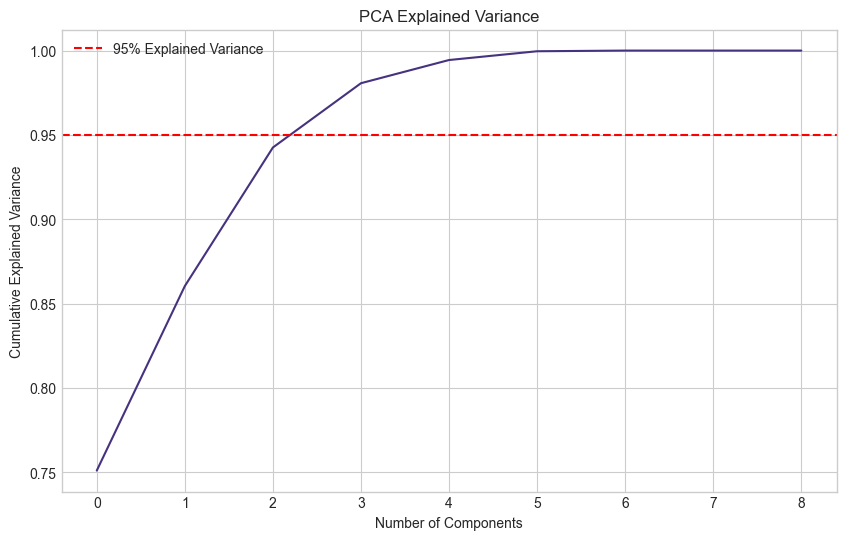

In [8]:
# Analyze class separability using dimensionality reduction
try:
    # Extract features from more images for a specific crop
    top_crop = summary_by_crop.sort_values('Disease Categories', ascending=False).index[0]
    feature_data = []
    
    max_samples_per_disease = 30
    disease_labels = []
    feature_vectors = []
    
    # Extract color and edge features
    crop_path = os.path.join(dataset_base_path, top_crop)
    diseases = os.listdir(crop_path)
    
    for disease in diseases:
        disease_path = os.path.join(crop_path, disease)
        
        if os.path.isdir(disease_path):
            image_files = os.listdir(disease_path)
            
            # Sample images
            samples = image_files[:max_samples_per_disease] if len(image_files) > max_samples_per_disease else image_files
            
            for img_file in samples:
                img_path = os.path.join(disease_path, img_file)
                
                try:
                    # Load and resize image
                    img = cv2.imread(img_path)
                    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                    img = cv2.resize(img, (100, 100))  # Resize for consistency
                    
                    # Extract simple features
                    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
                    
                    # Color features
                    avg_color = img.mean(axis=(0, 1))
                    std_color = img.std(axis=(0, 1))
                    
                    # Edge features
                    edges = cv2.Canny(img_gray, 100, 200)
                    edge_density = np.count_nonzero(edges) / (edges.shape[0] * edges.shape[1])
                    
                    # Create feature vector
                    features = np.concatenate([
                        avg_color, std_color, [edge_density],
                        [img_gray.mean()], [img_gray.std()]
                    ])
                    
                    feature_vectors.append(features)
                    disease_labels.append(disease)
                except Exception as img_error:
                    logger.warning(f"Error processing image for PCA: {img_path}")
    
    # Convert to numpy arrays
    feature_vectors = np.array(feature_vectors)
    
    # Apply PCA
    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(feature_vectors)
    
    # Apply t-SNE for better class separation
    tsne = TSNE(n_components=2, random_state=42)
    tsne_result = tsne.fit_transform(feature_vectors)
    
    # Create DataFrame for visualization
    df_pca = pd.DataFrame({
        'PCA1': pca_result[:, 0],
        'PCA2': pca_result[:, 1],
        'tSNE1': tsne_result[:, 0],
        'tSNE2': tsne_result[:, 1],
        'Disease': disease_labels
    })
    
    # Plot PCA results
    plt.figure(figsize=(16, 7))
    
    plt.subplot(1, 2, 1)
    sns.scatterplot(x='PCA1', y='PCA2', hue='Disease', data=df_pca, s=70, alpha=0.7)
    plt.title(f'PCA: Disease Classes Separability for {top_crop}', fontsize=15)
    plt.xlabel(f'Principal Component 1 ({pca.explained_variance_ratio_[0]:.2%} variance)')
    plt.ylabel(f'Principal Component 2 ({pca.explained_variance_ratio_[1]:.2%} variance)')
    plt.legend(title='Disease', bbox_to_anchor=(1.05, 1), loc='upper left')
    
    plt.subplot(1, 2, 2)
    sns.scatterplot(x='tSNE1', y='tSNE2', hue='Disease', data=df_pca, s=70, alpha=0.7)
    plt.title(f't-SNE: Disease Classes Separability for {top_crop}', fontsize=15)
    plt.xlabel('t-SNE Dimension 1')
    plt.ylabel('t-SNE Dimension 2')
    plt.legend(title='Disease', bbox_to_anchor=(1.05, 1), loc='upper left')
    
    plt.tight_layout()
    plt.show()
    
    # Plot explained variance ratio
    plt.figure(figsize=(10, 6))
    pca_full = PCA().fit(feature_vectors)
    plt.plot(np.cumsum(pca_full.explained_variance_ratio_))
    plt.xlabel('Number of Components')
    plt.ylabel('Cumulative Explained Variance')
    plt.title('PCA Explained Variance')
    plt.grid(True)
    plt.axhline(y=0.95, color='r', linestyle='--', label='95% Explained Variance')
    plt.legend()
    plt.show()
except Exception as e:
    logger.error(f"Error in class separability analysis: {str(e)}")


Analyzing image quality:   0%|          | 0/5 [00:00<?, ?it/s]

Image Quality Metrics Summary:
         blur_score    contrast  brightness  noise_level     entropy
count    280.000000  280.000000  280.000000   280.000000  280.000000
mean    3967.384245   44.426411  123.677230     7.717390    4.846448
std     2961.097677   11.494816   25.611886     3.462419    0.393784
min       15.255349   19.701534   56.443802     0.260340    2.638807
25%     1640.970343   36.508379  108.969830     5.303291    4.731174
50%     3458.538901   43.836993  121.180855     7.576393    4.955276
75%     5488.783098   50.673745  133.359169     9.928761    5.088052
max    14767.691979   78.820681  234.559326    18.250015    5.333951


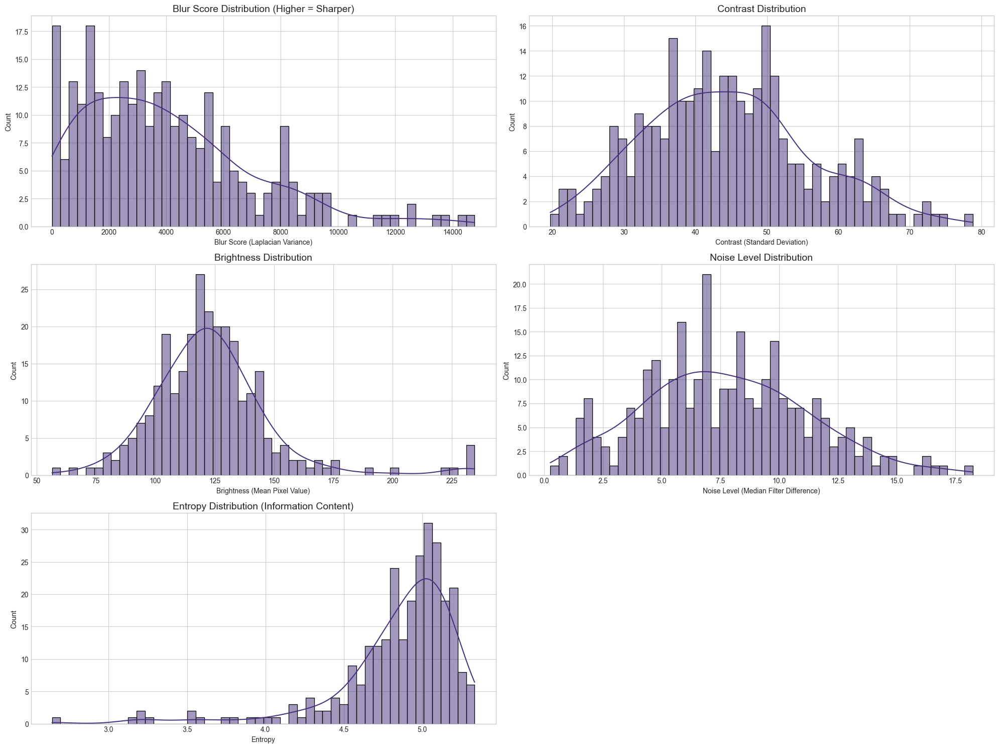

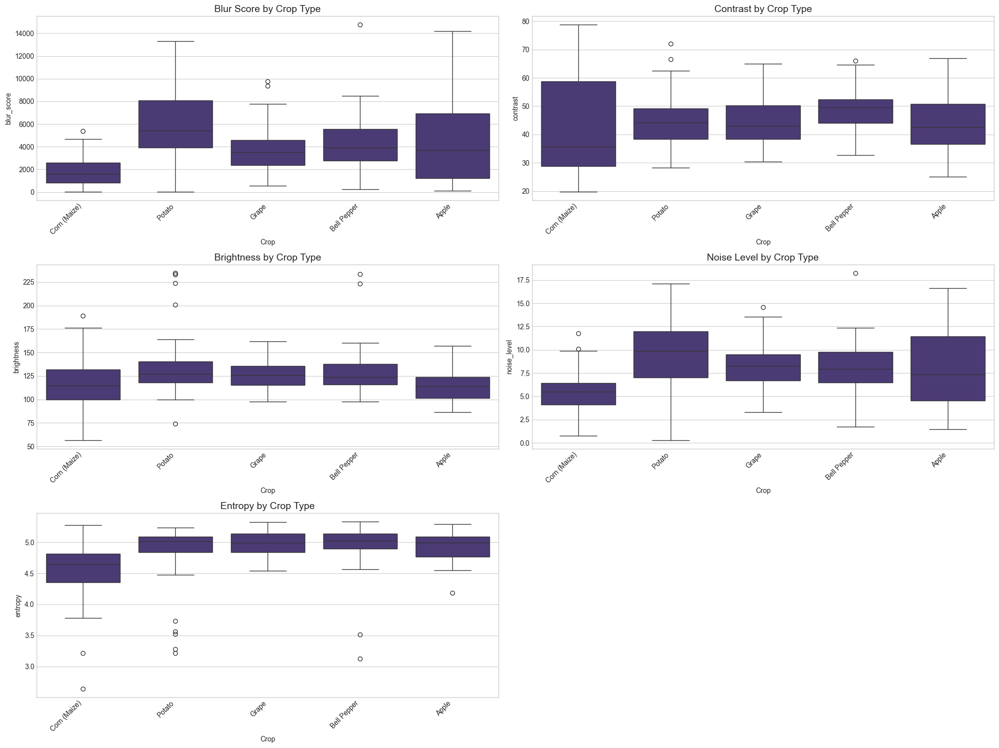

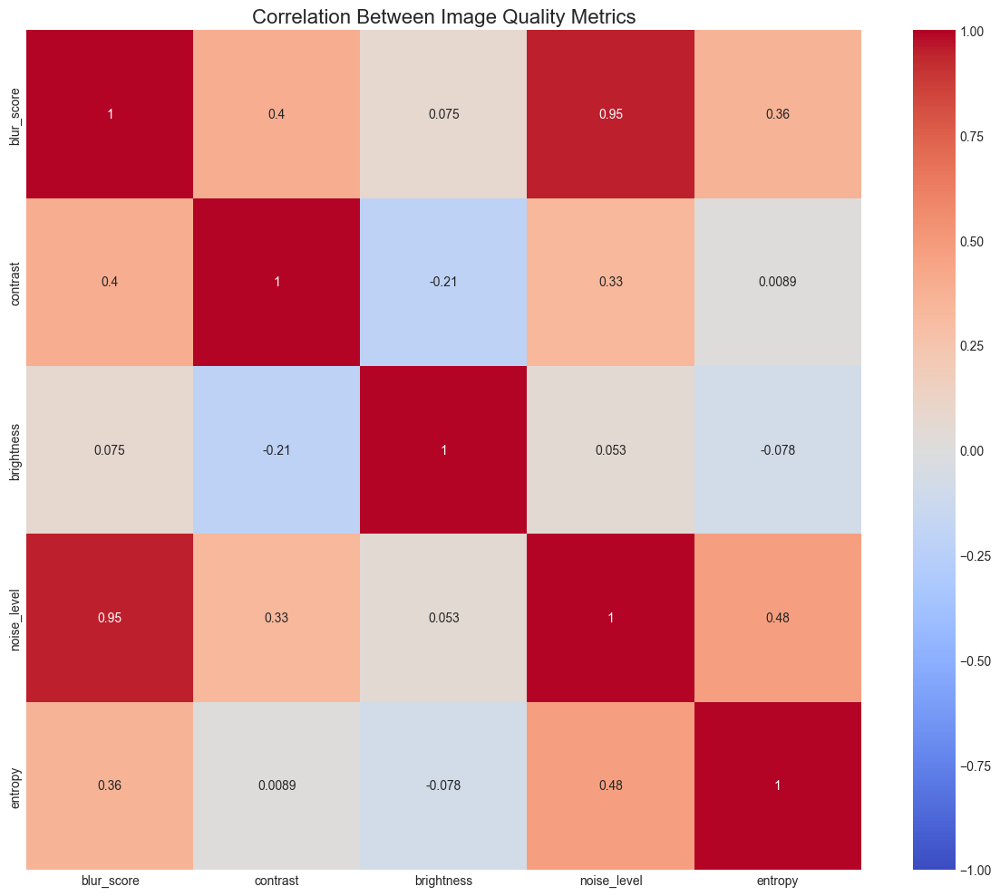


Identifying potentially problematic images:
Found 28 potentially blurry images (blur score < 714.77)
Found 28 potentially too dark images (brightness < 98.10)
Found 28 potentially too bright images (brightness > 147.13)
Found 28 potentially noisy images (noise level > 12.23)


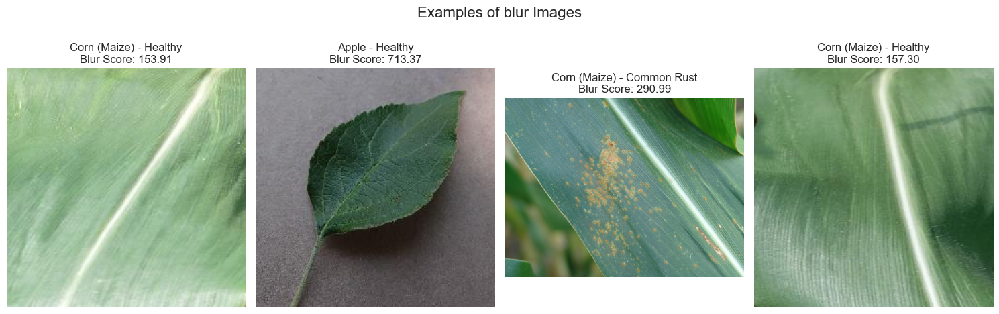

2025-03-30 12:21:34,451 - ERROR - Error displaying problematic image ../dataset\Apple\Black Rot\c225a3a5-4b7f-4226-aa70-73c9ce8d3de2___JR_FrgE.S 8722_new30degFlipLR.JPG: 'brightness_score'
2025-03-30 12:21:34,468 - ERROR - Error displaying problematic image ../dataset\Apple\Healthy\95884f1c-6886-41a1-9ce3-cffa1dcaf8e5___RS_HL 6051_flipTB.JPG: 'brightness_score'
2025-03-30 12:21:34,482 - ERROR - Error displaying problematic image ../dataset\Corn (Maize)\Common Rust\RS_Rust 2703.JPG: 'brightness_score'
2025-03-30 12:21:34,496 - ERROR - Error displaying problematic image ../dataset\Grape\Healthy\28c615fe-bb32-4003-9178-1f130c84c0a3___Mt.N.V_HL 9129_new30degFlipLR.JPG: 'brightness_score'


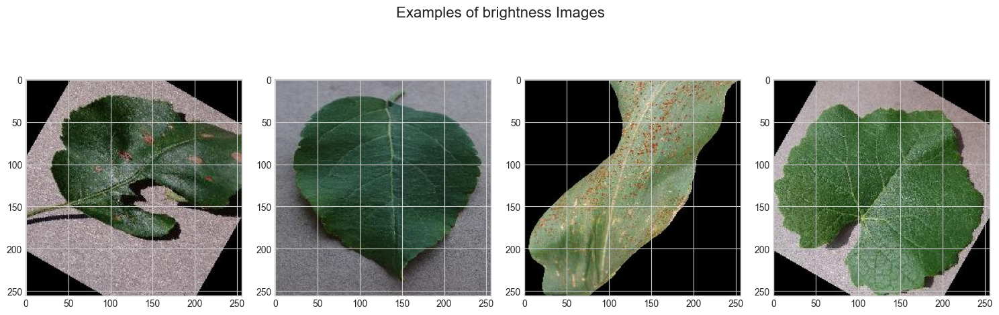

2025-03-30 12:21:35,049 - ERROR - Error displaying problematic image ../dataset\Corn (Maize)\Healthy\61088927-8b39-475f-a426-15b4f9969871___R.S_HL 7996 copy 2_flipLR.jpg: 'brightness_score'
2025-03-30 12:21:35,069 - ERROR - Error displaying problematic image ../dataset\Potato\Healthy\e1b49d1b-165b-4f4e-8a30-735e62bc39c5___RS_HL 1839_newPixel25.JPG: 'brightness_score'
2025-03-30 12:21:35,085 - ERROR - Error displaying problematic image ../dataset\Potato\Healthy\415ac4a2-8f16-4052-880e-1e1f208965f0___RS_HL 1884_newPixel25.JPG: 'brightness_score'
2025-03-30 12:21:35,100 - ERROR - Error displaying problematic image ../dataset\Grape\Healthy\9ceba66a-d7b0-4ed4-98c3-37d361517a90___Mt.N.V_HL 6147.JPG: 'brightness_score'


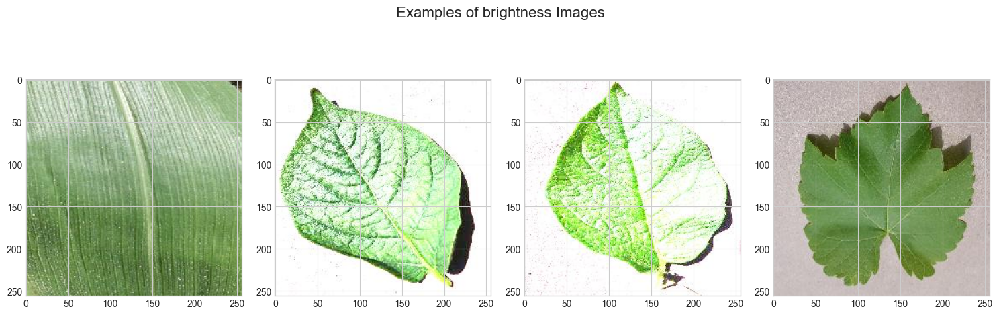

2025-03-30 12:21:35,647 - ERROR - Error displaying problematic image ../dataset\Potato\Early Blight\efa2f117-a774-4fcc-8445-142742aa7816___RS_Early.B 7458.JPG: 'noise_score'
2025-03-30 12:21:35,661 - ERROR - Error displaying problematic image ../dataset\Grape\Leaf Blight\8c555cf5-c6c8-400c-a764-a1b2ed7e66cd___FAM_L.Blight 1576_flipLR.JPG: 'noise_score'
2025-03-30 12:21:35,677 - ERROR - Error displaying problematic image ../dataset\Apple\Black Rot\7f1f4f8b-86cc-4cc5-bb70-8b1653cea8ae___JR_FrgE.S 8649_270deg.JPG: 'noise_score'
2025-03-30 12:21:35,690 - ERROR - Error displaying problematic image ../dataset\Apple\Black Rot\35ca99d4-5913-457a-b09c-3e90f6ef98a3___JR_FrgE.S 2947.JPG: 'noise_score'


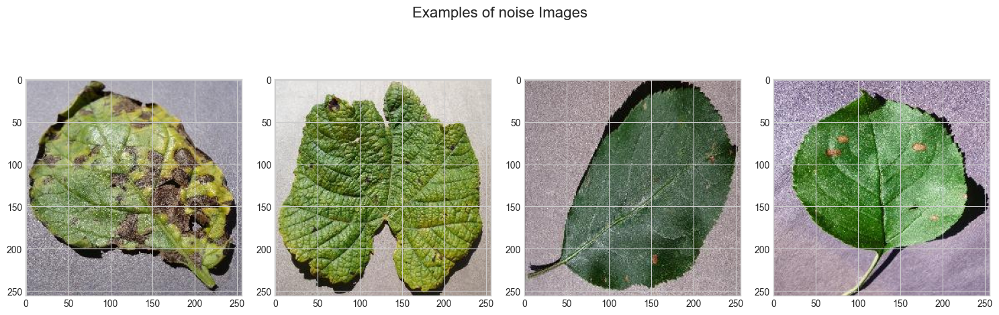

In [9]:
# %% [markdown]
# ## Image Quality Analysis

# %%
# Analyze image quality across the dataset
try:
    # Function to assess image quality
    def assess_image_quality(img_path):
        try:
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            
            # Convert to grayscale for quality metrics
            gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
            
            # Blur detection using Laplacian variance
            laplacian_var = cv2.Laplacian(gray, cv2.CV_64F).var()
            
            # Contrast measurement
            contrast = gray.std()
            
            # Brightness
            brightness = gray.mean()
            
            # Noise estimation (using median filter difference)
            median_filtered = cv2.medianBlur(gray, 3)
            noise_level = np.mean(np.abs(gray.astype(np.float32) - median_filtered.astype(np.float32)))
            
            # Calculate image entropy (measure of information content)
            entropy = stats.entropy(np.histogram(gray, bins=256, range=(0, 256))[0])
            
            return {
                'blur_score': laplacian_var,
                'contrast': contrast,
                'brightness': brightness,
                'noise_level': noise_level,
                'entropy': entropy
            }
        except Exception as e:
            logger.error(f"Error assessing image quality for {img_path}: {str(e)}")
            return None
    
    # Sample images from each category for quality assessment
    quality_data = []
    
    # Limit the number of samples to avoid excessive computation
    max_crops = 5
    max_diseases_per_crop = 3
    max_images_per_disease = 20
    
    sampled_crops = list(dataset_structure.keys())
    if len(sampled_crops) > max_crops:
        sampled_crops = random.sample(sampled_crops, max_crops)
    
    for crop in tqdm(sampled_crops, desc="Analyzing image quality"):
        crop_path = os.path.join(dataset_base_path, crop)
        diseases = list(dataset_structure[crop].keys())
        
        sampled_diseases = diseases
        if len(diseases) > max_diseases_per_crop:
            sampled_diseases = random.sample(diseases, max_diseases_per_crop)
        
        for disease in sampled_diseases:
            disease_path = os.path.join(crop_path, disease)
            image_files = os.listdir(disease_path)
            
            sampled_images = image_files
            if len(image_files) > max_images_per_disease:
                sampled_images = random.sample(image_files, max_images_per_disease)
            
            for img_file in sampled_images:
                img_path = os.path.join(disease_path, img_file)
                quality_metrics = assess_image_quality(img_path)
                
                if quality_metrics:
                    quality_data.append({
                        'Crop': crop,
                        'Disease': disease,
                        'Filename': img_file,
                        **quality_metrics
                    })
    
    # Convert to DataFrame
    df_quality = pd.DataFrame(quality_data)
    
    # Display summary statistics
    print("Image Quality Metrics Summary:")
    print(df_quality.describe())
    
    # Visualize quality metrics distribution
    plt.figure(figsize=(20, 15))
    
    # Blur score distribution
    plt.subplot(3, 2, 1)
    sns.histplot(df_quality['blur_score'], kde=True, bins=50)
    plt.title('Blur Score Distribution (Higher = Sharper)', fontsize=14)
    plt.xlabel('Blur Score (Laplacian Variance)')
    
    # Contrast distribution
    plt.subplot(3, 2, 2)
    sns.histplot(df_quality['contrast'], kde=True, bins=50)
    plt.title('Contrast Distribution', fontsize=14)
    plt.xlabel('Contrast (Standard Deviation)')
    
    # Brightness distribution
    plt.subplot(3, 2, 3)
    sns.histplot(df_quality['brightness'], kde=True, bins=50)
    plt.title('Brightness Distribution', fontsize=14)
    plt.xlabel('Brightness (Mean Pixel Value)')
    
    # Noise level distribution
    plt.subplot(3, 2, 4)
    sns.histplot(df_quality['noise_level'], kde=True, bins=50)
    plt.title('Noise Level Distribution', fontsize=14)
    plt.xlabel('Noise Level (Median Filter Difference)')
    
    # Entropy distribution
    plt.subplot(3, 2, 5)
    sns.histplot(df_quality['entropy'], kde=True, bins=50)
    plt.title('Entropy Distribution (Information Content)', fontsize=14)
    plt.xlabel('Entropy')
    
    plt.tight_layout()
    plt.show()
    
    # Quality metrics by crop type
    plt.figure(figsize=(20, 15))
    
    plt.subplot(3, 2, 1)
    sns.boxplot(x='Crop', y='blur_score', data=df_quality)
    plt.title('Blur Score by Crop Type', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    
    plt.subplot(3, 2, 2)
    sns.boxplot(x='Crop', y='contrast', data=df_quality)
    plt.title('Contrast by Crop Type', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    
    plt.subplot(3, 2, 3)
    sns.boxplot(x='Crop', y='brightness', data=df_quality)
    plt.title('Brightness by Crop Type', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    
    plt.subplot(3, 2, 4)
    sns.boxplot(x='Crop', y='noise_level', data=df_quality)
    plt.title('Noise Level by Crop Type', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    
    plt.subplot(3, 2, 5)
    sns.boxplot(x='Crop', y='entropy', data=df_quality)
    plt.title('Entropy by Crop Type', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    
    plt.tight_layout()
    plt.show()
    
    # Quality metrics correlation
    plt.figure(figsize=(12, 10))
    quality_corr = df_quality[['blur_score', 'contrast', 'brightness', 'noise_level', 'entropy']].corr()
    sns.heatmap(quality_corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
    plt.title('Correlation Between Image Quality Metrics', fontsize=16)
    plt.tight_layout()
    plt.show()
    
    # Identify potentially problematic images
    print("\nIdentifying potentially problematic images:")
    
    # Low quality images (low blur score = blurry)
    blur_threshold = df_quality['blur_score'].quantile(0.1)  # Bottom 10% of sharpness
    blurry_images = df_quality[df_quality['blur_score'] < blur_threshold]
    print(f"Found {len(blurry_images)} potentially blurry images (blur score < {blur_threshold:.2f})")
    
    # Extreme brightness (too dark or too bright)
    dark_threshold = df_quality['brightness'].quantile(0.1)
    bright_threshold = df_quality['brightness'].quantile(0.9)
    dark_images = df_quality[df_quality['brightness'] < dark_threshold]
    bright_images = df_quality[df_quality['brightness'] > bright_threshold]
    print(f"Found {len(dark_images)} potentially too dark images (brightness < {dark_threshold:.2f})")
    print(f"Found {len(bright_images)} potentially too bright images (brightness > {bright_threshold:.2f})")
    
    # High noise
    noise_threshold = df_quality['noise_level'].quantile(0.9)
    noisy_images = df_quality[df_quality['noise_level'] > noise_threshold]
    print(f"Found {len(noisy_images)} potentially noisy images (noise level > {noise_threshold:.2f})")
    
    # Display examples of potentially problematic images
    def show_problematic_examples(df_subset, title, max_examples=4):
        if len(df_subset) == 0:
            print(f"No {title} images found.")
            return
        
        examples = df_subset.sample(min(max_examples, len(df_subset)))
        
        plt.figure(figsize=(15, 5))
        plt.suptitle(f'Examples of {title} Images', fontsize=16)
        
        for i, (_, row) in enumerate(examples.iterrows()):
            crop = row['Crop']
            disease = row['Disease']
            filename = row['Filename']
            img_path = os.path.join(dataset_base_path, crop, disease, filename)
            
            try:
                img = Image.open(img_path).convert('RGB')
                
                plt.subplot(1, max_examples, i + 1)
                plt.imshow(img)
                plt.title(f"{crop} - {disease}\n{title.capitalize()} Score: {row[title+'_score']:.2f}")
                plt.axis('off')
            except Exception as e:
                logger.error(f"Error displaying problematic image {img_path}: {str(e)}")
        
        plt.tight_layout()
        plt.subplots_adjust(top=0.85)
        plt.show()
    
    # Rename columns for the display function
    df_quality_display = df_quality.copy()
    df_quality_display['blur_score'] = df_quality['blur_score']
    df_quality_display['brightness_score'] = df_quality['brightness']
    df_quality_display['noise_score'] = df_quality['noise_level']
    
    # Show examples
    show_problematic_examples(blurry_images, 'blur')
    show_problematic_examples(dark_images, 'brightness')
    show_problematic_examples(bright_images, 'brightness')
    show_problematic_examples(noisy_images, 'noise')
    
except Exception as e:
    logger.error(f"Error in image quality analysis: {str(e)}")
